In [1]:
import torch
from torch.nn import CrossEntropyLoss
from torch.utils.data import DataLoader
import numpy as np
import os
import nrrd
import pytorch_lightning as pl #python -m pip install lightning
from monai.data import Dataset, DataLoader
from monai.transforms import Compose, Lambda, RandSpatialCrop, RandRotate90, ToTensor
from monai.networks.nets import AutoEncoder
#from monai.losses import DiceLoss
from torch.utils.tensorboard import SummaryWriter
import matplotlib.pyplot as plt
from pytorch_lightning.callbacks import ModelCheckpoint
import torch.nn as nn
import torch.optim.lr_scheduler as lr_scheduler
import time

In [2]:
class SlicePlotter:
    def __init__(self):
        pass

    def plot_slices(self, original_slice, reconstruction_slice, title):
        plt.figure(figsize=(10, 5))
        plt.subplot(1, 2, 1)
        plt.imshow(original_slice, cmap='gray')
        plt.title(f'Original {title} Slice')
        plt.subplot(1, 2, 2)
        plt.imshow(reconstruction_slice, cmap='gray')
        plt.title(f'Reconstructed {title} Slice')
        plt.show()

class VolumePlotter:
    def __init__(self):
        self.color_map = np.array([
            [0, 0, 0, 0],      # Transparent for background (0)
            [255, 0, 0, 255],  # Red for arteries (1)
            [0, 0, 255, 255]   # Blue for veins (2)
        ], dtype=np.uint8)
        self.downsample_factor = 2

    def plot_volumes(self, original_volume, reconstruction_volume, title):
        # Downsample original volume
        original_volume_downsampled = original_volume[::self.downsample_factor, 
                                                       ::self.downsample_factor, 
                                                       ::self.downsample_factor]

        # Downsample reconstructed volume
        reconstruction_volume_downsampled = reconstruction_volume[::self.downsample_factor, 
                                                                   ::self.downsample_factor, 
                                                                   ::self.downsample_factor]

        # Downsample color map along the first axis to match the number of unique values in the downsampled volume
        color_map_downsampled = self.color_map[:len(np.unique(original_volume_downsampled))]

        # Plot original and reconstructed volumes with titles using Matplotlib
        fig = plt.figure(figsize=(10, 5))

        # Plot original volume with assigned colors and no edge color
        ax1 = fig.add_subplot(121, projection='3d')
        ax1.set_title(f'Original {title} Volume')

        # Define colors for each voxel value in the original volume using the downsampled color map
        original_colors = np.take(color_map_downsampled, original_volume_downsampled, axis=0) / 255.0
        ax1.voxels(original_volume_downsampled, facecolors=original_colors)

        # Plot reconstructed volume with assigned colors and no edge color
        ax2 = fig.add_subplot(122, projection='3d')
        ax2.set_title(f'Reconstructed {title} Volume')

        # Define colors for each voxel value in the reconstructed volume using the downsampled color map
        reconstruction_colors = np.take(color_map_downsampled, reconstruction_volume_downsampled, axis=0) / 255.0
        ax2.voxels(reconstruction_volume_downsampled, facecolors=reconstruction_colors)

        plt.show()

class AutoEncoderModel(pl.LightningModule):
    def __init__(self):
        super().__init__()
        self.autoencoder = AutoEncoder(
            spatial_dims=3, 
            in_channels=1, 
            out_channels=3,  # Output channels set to 3
            channels=(16, 32, 64, 128, 4), 
            strides=(2, 2, 2, 2, 2), 
            kernel_size=3, 
            num_res_units=2
        )
        # Define class weights
        class_weights = torch.tensor([0.2, 0.4, 0.4])
        self.loss_function = nn.CrossEntropyLoss(weight=class_weights)
        self.volume_plotter = VolumePlotter()  # Instantiate VolumePlotter

    def forward(self, x):
        return self.autoencoder(x)

    def training_step(self, batch, batch_idx):
        x, y = batch
        x, y = x.to(device), y.to(device)
        x_hat = self(x)
        loss = self.loss_function(x_hat, y.squeeze(1).long())
        self.log('train_loss', loss)

        if (self.current_epoch) % 300 == 0 and batch_idx == 0:
            original_volume = x[0, 0, :, :, :].detach().cpu().numpy().astype(int)  
            reconstruction_volume = np.argmax(x_hat[0,:,:,:,:].detach().cpu().numpy(), axis=0)
            self.volume_plotter.plot_volumes(original_volume, reconstruction_volume, 'Train')

        return loss

    def validation_step(self, batch, batch_idx):
        x, y = batch
        x, y = x.to(device), y.to(device)
        x_hat = self(x)
        loss = self.loss_function(x_hat, y.squeeze(1).long())
        self.log('val_loss', loss, prog_bar=True)

        if (self.current_epoch) % 300 == 0 and batch_idx == 0:
            original_volume = x[0, 0, :, :, :].detach().cpu().numpy().astype(int)  
            reconstruction_volume = np.argmax(x_hat[0,:,:,:,:].detach().cpu().numpy(), axis=0)
            self.volume_plotter.plot_volumes(original_volume, reconstruction_volume, 'Val')
            torch.save(model.state_dict(), folder_path + '/autoencoder.pth')

        return loss

    def configure_optimizers(self):
        optimizer = torch.optim.Adam(self.parameters(), lr=1e-3)
        return optimizer

class MyDataset(Dataset):
    def __init__(self, data_dir, transform=None):
        self.data_dir = data_dir
        self.transform = transform
        self.files = [f for f in os.listdir(data_dir) if f.endswith('.nrrd')]

    def __len__(self):
        return len(self.files)

    def __getitem__(self, idx):
        file_path = os.path.join(self.data_dir, self.files[idx])
        data, header = nrrd.read(file_path)
        if self.transform:
            data = self.transform(data)
        return data, data

# Define a custom callback to plot both training and validation losses

class PlotLossCallback(pl.Callback):
    def __init__(self, log_dir):
        super().__init__()
        self.log_dir = log_dir

    def on_train_start(self, trainer, pl_module):
        # Clear previous graphs
        #tf.compat.v1.reset_default_graph()
        self.writer = SummaryWriter(self.log_dir)

    def on_train_epoch_end(self, trainer, pl_module, **kwargs):
        epoch = trainer.current_epoch
        train_loss = trainer.callback_metrics['train_loss'].cpu().item()
        val_loss = trainer.callback_metrics['val_loss'].cpu().item()

        # Write both training and validation loss to the same graph with epoch as global step
        self.writer.add_scalars('MAE Job 17 Loss', {'training' : train_loss, 
                                                   'validation' : val_loss }, global_step=epoch +1 )
        time_spent = time.time() - start_time
        print(f"Time Spent {time_spent:.2f}")
    def on_train_end(self, trainer, pl_module):
        self.writer.close()

transform = Compose([
    Lambda(func=lambda x: np.expand_dims(x, 0) if x.ndim == 3 else x),
    RandSpatialCrop((256, 256, 256), random_size=False),
    RandRotate90(prob=0.5),
    ToTensor(dtype=torch.float32)
])

start_time = time.time()
device = torch.device("cuda" if torch.cuda.is_available() else "gpu")

folder_path = "./Models"
if not os.path.exists(folder_path):
        os.makedirs(folder_path)

# Define dataset and data loaders for both training and validation sets
train_data_dir = "../../TrainFullLabels70"
val_data_dir   = "../../ValFullLabels30"

train_dataset = MyDataset(train_data_dir, transform)
val_dataset   = MyDataset(val_data_dir  , transform)

train_dataloader = DataLoader(train_dataset, batch_size=2, shuffle=True , num_workers=2) #############################
val_dataloader   = DataLoader(val_dataset  , batch_size=2, shuffle=False, num_workers=2)


#early_stop_callback = pl.callbacks.EarlyStopping(monitor='val_loss', patience=80)
#getting rid of early stop callback for now 
# Define Lightning trainer

trainer = pl.Trainer(
    max_epochs=1501,
    callbacks=[PlotLossCallback("../../logs/")],
    profiler='simple')


GPU available: True (cuda), used: True


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


Missing logger folder: /old_Users/tgafrick/RA4/jobs/MAEjob17/lightning_logs


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]



  | Name          | Type             | Params
---------------------------------------------------
0 | autoencoder   | AutoEncoder      | 2.1 M 
1 | loss_function | CrossEntropyLoss | 0     
---------------------------------------------------
2.1 M     Trainable params
0         Non-trainable params
2.1 M     Total params
8.366     Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

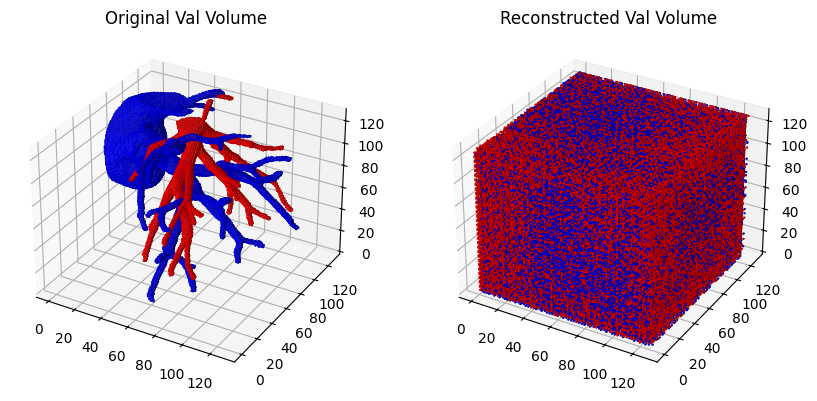

/old_Users/tgafrick/RA4/.venvE/lib/python3.10/site-packages/pytorch_lightning/loops/fit_loop.py:298: The number of training batches (9) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training: |          | 0/? [00:00<?, ?it/s]

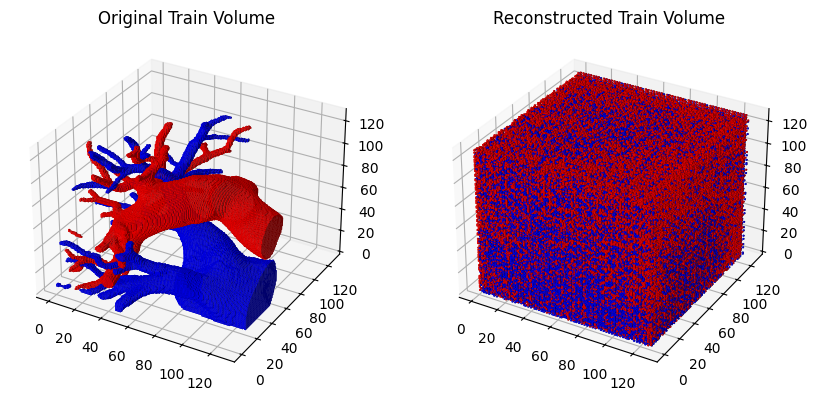

Validation: |          | 0/? [00:00<?, ?it/s]

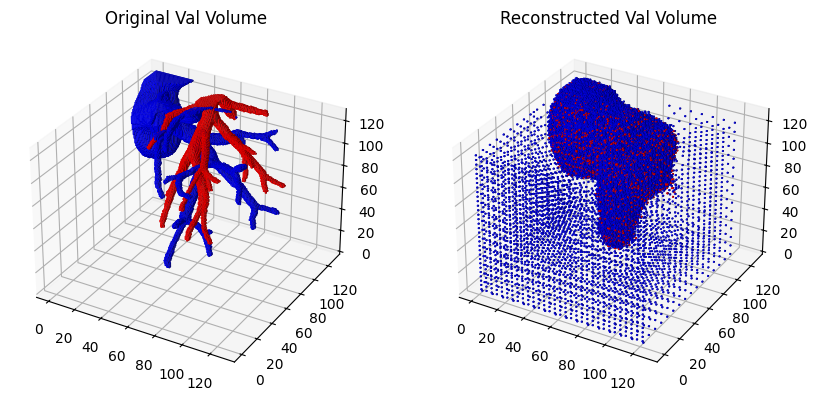

Time Spent 4313.42


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4347.69


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4381.28


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4416.55


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4450.39


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4484.12


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4517.88


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4551.31


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4587.21


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4620.76


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4654.94


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4688.38


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4721.59


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4755.27


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4790.31


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4825.49


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4858.88


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4892.68


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4927.68


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4963.67


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4997.59


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5032.23


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5067.57


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5102.76


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5138.01


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5171.51


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5205.19


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5242.46


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5278.62


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5313.10


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5346.66


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5380.04


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5414.17


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5448.27


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5483.49


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5517.67


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5551.37


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5584.85


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5620.13


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5654.19


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5688.67


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5721.97


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5757.36


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5791.44


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5825.06


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5862.09


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5896.48


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5932.28


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5965.83


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6002.26


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6037.11


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6070.83


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6104.38


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6139.97


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6176.12


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6209.54


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6243.67


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6277.48


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6311.79


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6345.36


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6379.21


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6412.85


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6448.90


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6483.01


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6518.89


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6555.36


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6588.67


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6622.40


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6656.25


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6689.51


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6722.58


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6756.35


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6792.11


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6825.79


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6859.37


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6892.82


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6928.69


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6963.03


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6996.19


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7030.48


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7064.36


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7098.44


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7134.05


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7168.24


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7204.20


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7238.15


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7272.38


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7305.90


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7339.50


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7373.26


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7406.99


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7441.03


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7475.51


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7509.02


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7544.81


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7580.34


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7613.80


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7647.82


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7683.14


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7719.00


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7753.27


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7788.32


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7822.68


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7857.12


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7892.85


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7927.71


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7961.32


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7994.37


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8027.80


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8061.77


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8097.07


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8131.68


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8167.30


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8201.01


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8235.00


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8269.15


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8302.74


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8339.56


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8373.28


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8406.54


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8441.68


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8477.11


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8510.66


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8543.80


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8577.08


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8612.49


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8646.78


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8680.99


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8714.44


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8748.27


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8782.87


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8816.56


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8852.03


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8885.80


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8921.12


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8955.11


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8988.52


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9022.34


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9056.96


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9090.58


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9127.86


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9160.96


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9194.99


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9230.04


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9264.56


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9298.40


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9333.52


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9367.61


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9401.71


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9439.45


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9475.64


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9509.12


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9543.01


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9576.56


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9610.99


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9644.49


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9678.40


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9713.53


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9746.75


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9779.86


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9813.10


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9846.88


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9880.78


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9914.55


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9950.02


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9983.75


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10018.63


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10052.17


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10085.78


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10120.66


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10154.00


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10188.41


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10222.44


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10255.90


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10289.19


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10322.32


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10355.91


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10390.00


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10425.06


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10460.09


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10493.43


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10527.06


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10561.03


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10596.32


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10630.32


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10663.68


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10696.87


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10730.12


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10763.50


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10797.05


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10833.50


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10867.24


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10901.20


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10936.62


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10970.71


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11005.11


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11038.83


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11074.17


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11109.70


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11146.23


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11179.99


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11213.52


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11247.31


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11281.15


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11315.32


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11351.73


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11386.44


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11420.65


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11455.82


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11491.50


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11526.37


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11561.39


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11598.27


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11633.83


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11671.43


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11709.78


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11746.56


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11781.13


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11815.38


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11859.79


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11894.96


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11969.01


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12019.73


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12068.02


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12116.35


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12150.01


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12183.37


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12218.22


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12252.40


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12288.00


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12321.94


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12355.45


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12388.72


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12422.25


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12455.60


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12488.89


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12524.41


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12559.32


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12593.16


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12627.03


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12660.73


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12695.76


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12731.40


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12780.77


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12836.68


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12872.14


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12905.78


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12939.26


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12973.32


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13009.69


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13043.89


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13079.55


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13113.30


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13146.96


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13181.07


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13215.14


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13250.31


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13296.64


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13332.47


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13367.82


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13401.01


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13434.81


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13472.26


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13506.29


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13542.32


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13577.51


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13612.76


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13649.90


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13684.96


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13718.20


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13753.85


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13788.14


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13822.00


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13855.53


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13890.00


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13923.60


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13957.35


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13994.37


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14028.79


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14062.86


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14098.36


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14132.57


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14167.50


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14201.26


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14234.58


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14268.98


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14302.08


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14335.72


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14370.98


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14405.01


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14438.81


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14474.52


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14507.77


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14543.11


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14577.48


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14610.64


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14647.95


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14681.96


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14716.56


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14752.62


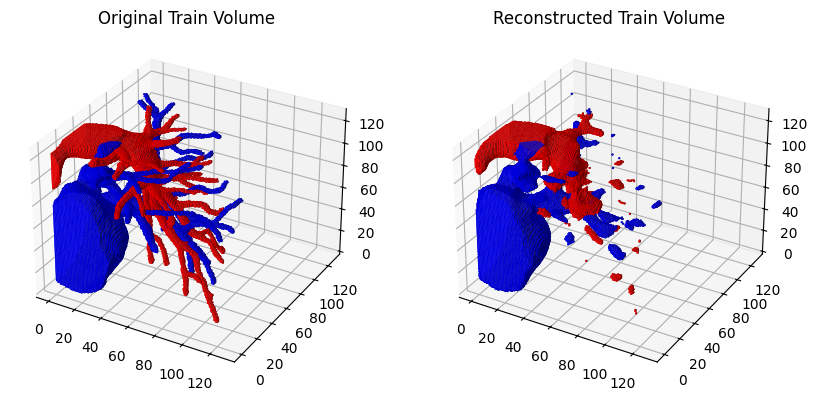

Validation: |          | 0/? [00:00<?, ?it/s]

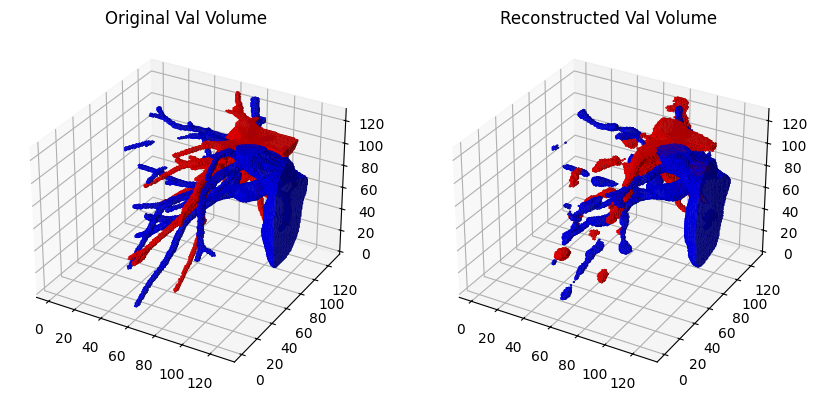

Time Spent 15199.87


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15233.20


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15267.37


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15301.32


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15335.20


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15369.39


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15402.71


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15436.44


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15472.09


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15506.39


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15539.78


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15573.16


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15608.60


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15642.11


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15675.45


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15709.70


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15743.84


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15778.54


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15811.86


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15847.24


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15882.87


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15918.10


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15951.85


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15985.86


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16019.43


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16053.41


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16090.46


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16124.42


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16157.60


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16192.57


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16227.60


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16262.82


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16296.45


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16330.06


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16363.85


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16399.07


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16432.77


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16466.02


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16502.13


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16536.59


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16571.88


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16605.89


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16640.03


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16673.65


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16707.56


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16740.63


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16774.02


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16809.79


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16845.03


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16881.14


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16915.21


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16948.96


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16982.21


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17016.07


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17049.59


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17083.19


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17116.85


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17150.39


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17184.17


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17217.85


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17253.14


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17287.51


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17321.17


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17354.93


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17388.69


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17422.06


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17455.62


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17489.20


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17524.45


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17557.38


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17590.67


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17624.69


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17658.08


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17694.00


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17727.59


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17761.02


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17794.62


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17828.49


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17861.86


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17896.18


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17932.08


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17966.35


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18000.38


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18036.27


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18069.91


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18103.57


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18136.98


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18171.50


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18205.82


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18239.30


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18273.79


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18308.12


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18343.42


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18378.70


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18414.29


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18449.72


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18483.39


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18518.14


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18552.02


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18588.09


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18624.17


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18659.44


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18692.94


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18726.88


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18761.13


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18795.24


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18828.75


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18862.79


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18898.55


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18934.07


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18967.92


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19003.61


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19038.10


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19072.65


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19106.52


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19140.58


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19174.33


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19208.33


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19242.16


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19276.04


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19309.44


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19342.60


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19376.68


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19410.05


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19443.45


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19476.42


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19509.82


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19545.62


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19580.40


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19614.44


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19649.62


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19683.49


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19716.94


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19752.76


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19788.11


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19821.64


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19855.06


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19888.57


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19922.68


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19955.91


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19989.35


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20023.80


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20057.29


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20090.70


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20124.70


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20158.33


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20191.68


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20225.19


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20259.52


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20296.55


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20332.35


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20366.54


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20401.48


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20435.13


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20471.05


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20505.02


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20538.91


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20572.17


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20606.13


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20639.21


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20673.03


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20707.07


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20741.78


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20775.72


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20808.86


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20844.18


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20878.26


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20913.95


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20948.97


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20982.74


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21015.93


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21049.15


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21082.20


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21116.25


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21149.58


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21185.32


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21219.43


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21253.22


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21287.59


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21321.49


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21357.11


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21390.22


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21423.94


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21457.35


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21492.71


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21525.74


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21559.19


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21592.77


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21627.98


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21661.46


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21695.84


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21729.18


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21766.40


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21799.67


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21833.54


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21867.60


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21901.56


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21934.57


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21967.94


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22003.70


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22037.00


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22070.42


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22103.81


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22138.72


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22171.65


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22205.27


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22238.43


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22271.79


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22305.77


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22338.91


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22372.74


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22405.56


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22439.02


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22472.30


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22505.77


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22541.13


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22575.49


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22608.93


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22644.11


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22677.47


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22711.32


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22745.22


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22779.93


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22813.63


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22847.45


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22882.81


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22916.73


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22950.82


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22984.34


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23018.02


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23052.07


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23086.19


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23121.45


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23156.53


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23190.29


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23223.59


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23259.04


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23293.13


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23326.54


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23359.61


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23395.10


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23428.34


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23461.88


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23495.61


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23529.90


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23563.11


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23596.83


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23630.89


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23664.39


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23699.95


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23733.34


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23766.64


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23800.27


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23833.41


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23866.95


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23901.14


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23934.88


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23969.41


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24003.18


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24036.64


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24070.95


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24105.49


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24139.42


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24172.72


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24206.06


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24239.16


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24272.49


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24306.17


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24339.56


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24375.07


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24408.77


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24442.77


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24478.09


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24511.26


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24545.96


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24581.10


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24614.50


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24648.41


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24681.74


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24714.71


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24748.25


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24782.35


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24815.91


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24849.52


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24884.67


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24918.61


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24955.72


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24991.01


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 25024.80


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 25058.67


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 25092.23


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 25127.39


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 25162.76


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 25197.84


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 25231.70


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 25267.28


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 25300.77


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 25336.27


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 25369.48


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 25407.16


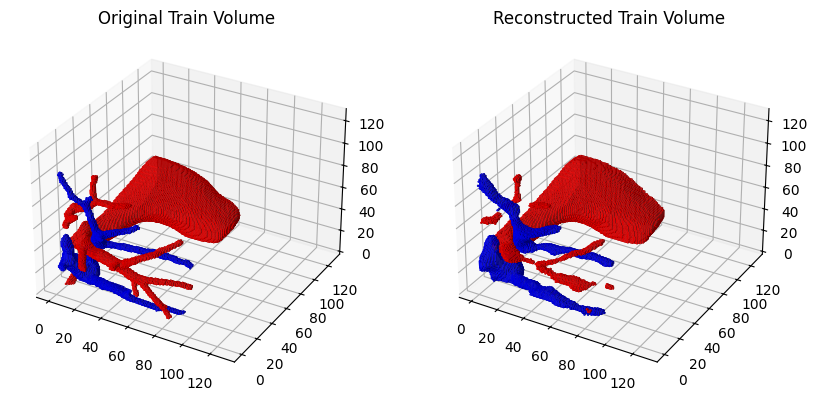

Validation: |          | 0/? [00:00<?, ?it/s]

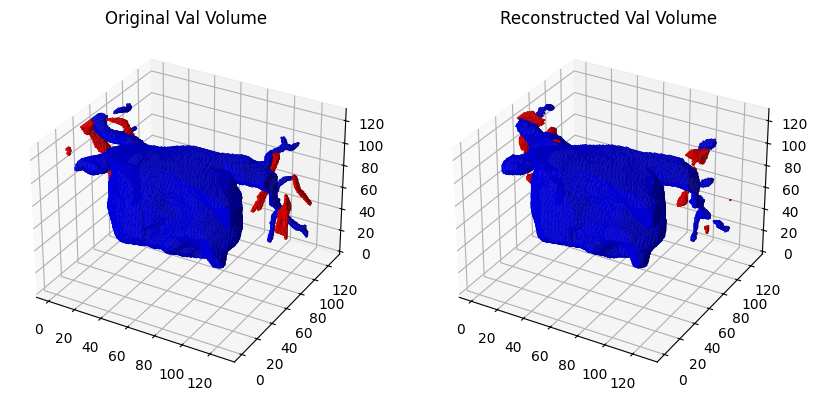

Time Spent 25798.79


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 25832.34


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 25866.87


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 25900.58


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 25933.78


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 25969.14


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26002.94


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26036.46


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26070.01


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26103.69


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26138.03


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26171.12


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26206.24


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26239.65


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26275.15


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26309.89


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26343.10


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26376.96


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26410.23


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26443.57


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26477.43


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26510.87


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26546.25


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26579.54


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26615.18


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26647.98


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26681.27


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26716.40


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26750.28


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26785.02


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26818.48


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26853.89


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26889.13


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26923.22


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26956.77


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26989.92


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27023.57


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27056.77


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27092.27


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27127.38


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27160.97


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27195.38


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27228.60


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27262.32


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27296.09


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27331.37


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27365.14


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27398.68


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27432.18


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27469.28


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27502.55


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27536.77


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27570.34


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27604.49


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27640.07


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27673.30


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27707.34


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27740.86


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27774.47


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27808.96


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27842.06


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27876.44


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27909.77


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27943.18


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27977.01


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28010.69


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28044.07


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28077.62


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28112.41


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28146.06


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28179.34


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28212.78


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28248.30


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28281.91


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28315.31


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28348.67


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28382.00


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28415.51


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28450.99


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28484.56


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28520.11


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28553.38


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28587.69


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28621.67


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28655.10


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28688.91


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28722.84


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28756.77


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28790.50


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28824.09


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28857.68


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28890.86


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28926.38


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28960.04


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28993.74


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29028.73


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29061.68


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29096.22


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29129.68


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29165.90


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29199.55


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29233.27


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29268.62


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29302.04


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29335.27


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29368.42


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29401.45


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29435.53


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29468.97


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29502.43


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29535.91


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29570.90


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29604.40


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29637.45


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29671.36


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29704.31


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29738.10


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29771.32


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29804.31


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29837.48


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29871.19


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29904.60


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29938.58


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29973.78


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30007.59


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30041.20


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30075.33


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30109.44


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30143.67


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30177.27


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30210.30


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30243.60


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30277.98


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30310.89


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30344.60


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30377.90


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30411.54


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30446.80


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30480.77


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30516.45


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30551.26


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30584.91


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30618.84


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30652.29


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30686.07


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30721.09


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30757.01


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30792.87


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30826.16


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30863.57


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30896.54


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30931.54


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30965.30


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31000.37


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31035.52


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31069.09


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31102.29


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31135.58


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31168.82


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31202.77


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31236.26


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31270.26


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31304.05


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31339.41


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31373.41


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31407.05


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31441.84


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31476.83


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31510.14


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31544.15


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31577.98


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31612.01


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31645.99


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31679.87


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31713.90


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31747.35


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31780.88


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31814.72


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31848.64


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31882.70


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31916.03


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31950.35


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31985.33


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32019.41


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32052.87


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32086.82


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32120.57


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32155.94


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32189.59


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32222.79


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32256.32


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32290.10


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32325.27


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32359.47


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32392.42


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32427.46


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32462.42


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32496.47


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32530.11


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32568.39


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32601.60


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32635.94


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32668.63


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32702.56


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32736.41


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32770.28


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32803.48


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32836.90


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32870.19


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32904.38


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32938.09


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32971.20


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33006.20


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33039.44


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33074.73


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33107.87


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33141.22


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33174.46


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33208.50


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33241.79


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33275.11


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33308.86


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33343.20


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33376.52


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33410.56


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33445.62


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33481.53


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33514.75


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33548.57


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33584.20


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33619.17


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33652.49


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33686.42


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33721.40


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33754.46


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33787.69


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33820.96


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33854.46


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33887.78


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33923.69


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33956.83


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33990.63


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34023.78


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34059.00


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34093.23


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34128.71


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34162.76


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34196.71


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34231.55


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34268.29


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34304.05


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34337.92


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34371.72


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34405.60


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34440.46


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34474.62


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34507.90


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34541.80


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34575.53


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34609.12


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34644.05


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34677.62


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34712.70


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34746.22


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34778.98


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34812.12


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34847.37


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34880.25


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34913.92


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34951.06


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34985.24


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35018.32


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35051.97


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35086.26


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35120.46


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35153.88


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35189.21


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35222.59


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35256.21


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35289.65


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35322.74


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35357.85


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35391.58


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35425.18


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35458.72


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35493.68


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35527.24


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35560.24


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35594.48


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35629.14


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35662.24


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35697.64


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35732.79


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35766.56


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35802.29


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35835.30


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35869.66


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35904.99


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35938.41


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35974.04


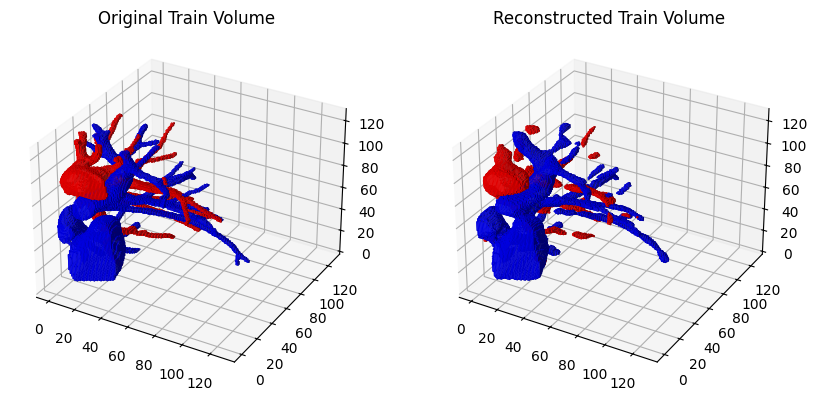

Validation: |          | 0/? [00:00<?, ?it/s]

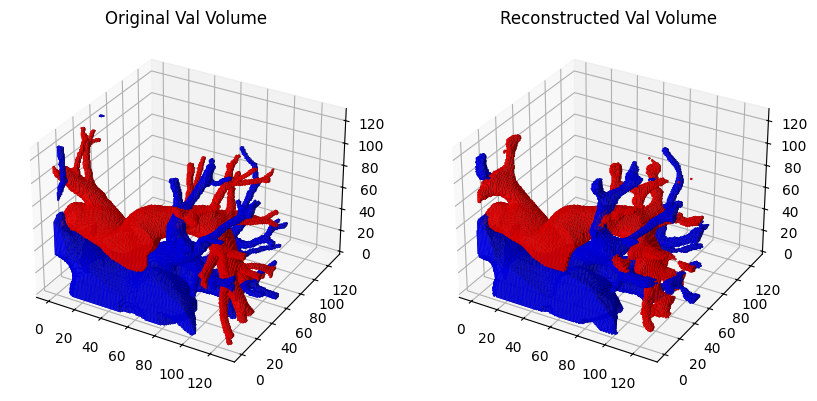

Time Spent 36442.59


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 36475.51


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 36508.59


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 36542.14


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 36575.89


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 36609.41


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 36643.33


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 36678.40


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 36713.77


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 36747.30


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 36782.10


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 36815.83


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 36849.73


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 36883.21


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 36916.21


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 36949.96


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 36983.25


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37017.16


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37050.25


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37084.11


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37119.51


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37154.43


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37188.88


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37222.29


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37255.79


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37289.17


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37324.50


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37357.89


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37391.72


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37427.47


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37460.39


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37493.50


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37526.87


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37559.96


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37593.43


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37626.89


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37660.46


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37693.92


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37727.10


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37762.62


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37796.78


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37830.69


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37864.74


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37899.97


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37933.21


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37966.86


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38002.20


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38035.37


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38068.95


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38104.66


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38138.14


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38171.77


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38207.02


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38242.35


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38277.51


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38311.13


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38345.31


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38378.77


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38412.31


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38446.37


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38481.53


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38515.05


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38549.27


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38584.48


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38617.44


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38650.53


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38684.54


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38717.82


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38751.25


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38784.80


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38820.08


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38853.54


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38887.13


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38922.55


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38955.73


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38989.47


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39022.98


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39055.76


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39089.16


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39123.11


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39156.25


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39190.88


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39223.75


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39258.48


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39291.90


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39325.94


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39358.84


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39393.07


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39427.28


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39463.99


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39498.97


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39532.63


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39566.05


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39599.96


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39633.98


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39667.92


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39702.25


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39737.39


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39771.10


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39807.35


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39840.89


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39875.86


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39909.53


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39942.92


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39976.11


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40009.32


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40042.42


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40075.89


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40108.67


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40142.07


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40175.70


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40211.46


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40246.17


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40279.08


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40312.54


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40347.78


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40380.87


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40414.59


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40447.66


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40481.08


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40516.64


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40552.91


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40586.84


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40619.98


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40653.12


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40686.77


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40720.75


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40755.86


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40789.32


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40824.07


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40857.75


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40891.59


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40924.85


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40958.81


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40994.58


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41028.04


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41062.84


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41096.50


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41130.36


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41163.64


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41197.48


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41232.63


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41266.04


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41300.07


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41333.72


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41366.89


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41399.85


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41433.46


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41467.35


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41503.39


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41536.59


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41569.95


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41605.78


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41638.98


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41672.51


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41705.69


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41739.01


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41772.97


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41806.97


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41840.01


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41873.60


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41907.59


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41941.07


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41974.70


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42007.51


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42040.49


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42073.99


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42107.19


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42140.25


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42174.53


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42209.93


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42243.35


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42277.29


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42312.91


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42346.32


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42380.17


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42413.73


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42448.81


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42481.72


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42514.98


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42550.07


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42583.85


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42617.30


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42653.31


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42687.24


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42722.25


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42755.72


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42789.24


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42823.05


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42856.67


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42889.68


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42922.79


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42956.16


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42989.77


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43025.42


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43059.42


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43093.47


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43127.63


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43163.16


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43198.29


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43233.26


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43266.09


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43299.90


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43333.26


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43366.66


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43400.71


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43436.19


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43469.80


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43505.12


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43538.50


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43573.70


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43608.93


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43642.59


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43675.66


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43709.19


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43742.47


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43776.28


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43809.41


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43843.31


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43877.47


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43910.55


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43944.17


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43979.80


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44013.70


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44049.00


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44082.89


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44116.05


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44149.56


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44182.89


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44217.71


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44250.95


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44285.10


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44320.19


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44354.22


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44387.93


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44420.97


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44454.90


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44488.58


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44521.93


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44555.69


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44589.31


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44622.72


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44656.32


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44689.24


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44723.56


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44756.62


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44789.52


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44824.71


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44858.34


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44894.46


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44927.49


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44962.56


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44997.67


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45031.53


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45065.10


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45100.91


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45134.38


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45167.31


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45200.36


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45234.05


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45267.86


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45300.82


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45335.85


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45371.12


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45404.57


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45437.51


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45471.25


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45506.90


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45541.08


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45574.72


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45608.33


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45641.92


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45675.27


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45710.92


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45745.00


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45778.35


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45813.80


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45847.98


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45881.56


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45916.46


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45950.02


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45984.34


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 46020.04


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 46053.80


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 46087.48


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 46120.75


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 46153.71


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 46186.93


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 46220.26


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 46253.81


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 46287.02


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 46320.51


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 46354.28


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 46387.23


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 46421.70


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 46455.33


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 46489.14


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 46524.27


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 46557.31


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 46593.23


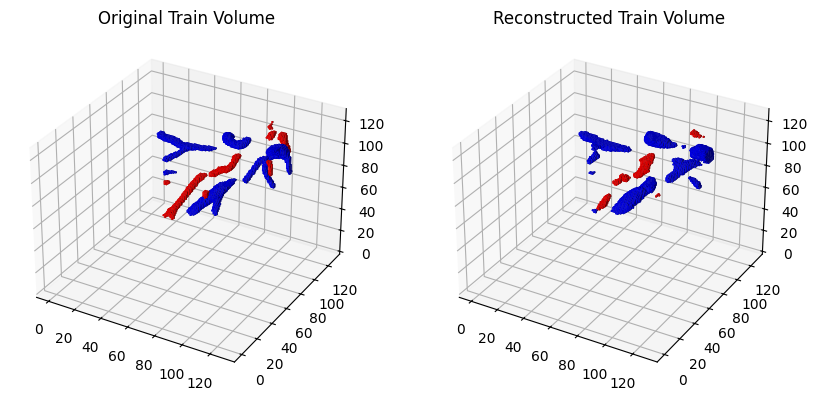

Validation: |          | 0/? [00:00<?, ?it/s]

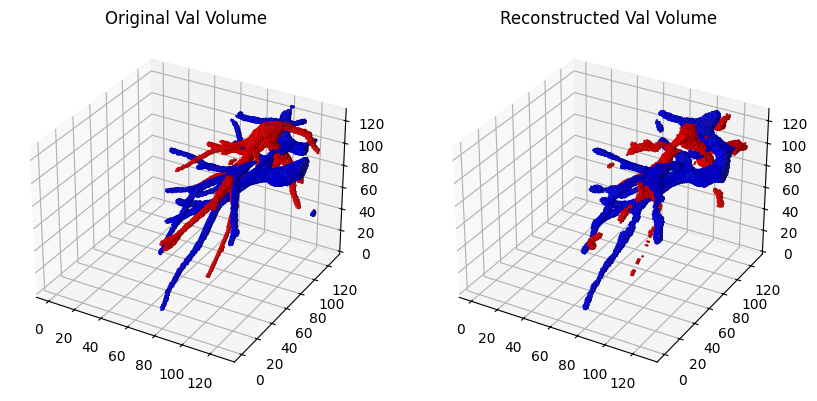

Time Spent 46868.45


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 46903.87


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 46937.22


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 46970.12


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47003.38


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47037.28


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47071.49


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47105.34


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47138.85


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47174.14


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47207.59


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47241.35


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47275.47


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47308.72


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47342.58


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47376.60


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47410.19


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47442.90


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47477.38


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47510.79


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47544.19


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47577.94


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47612.80


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47648.17


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47681.24


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47714.28


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47747.41


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47781.44


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47815.03


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47848.22


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47881.54


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47915.32


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47949.12


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47982.91


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48019.99


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48053.04


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48087.66


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48120.97


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48155.05


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48189.92


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48222.99


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48256.07


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48289.82


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48323.31


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48356.61


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48390.27


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48423.76


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48457.44


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48492.55


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48528.55


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48561.48


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48594.70


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48628.58


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48662.10


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48695.74


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48730.83


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48763.58


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48797.26


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48830.87


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48865.71


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48900.76


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48933.95


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48969.15


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49003.48


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49038.99


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49074.05


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49107.29


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49140.69


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49173.43


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49207.72


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49240.86


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49274.35


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49307.76


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49341.43


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49374.55


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49408.11


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49443.53


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49477.43


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49512.96


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49546.77


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49579.55


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49613.31


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49646.90


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49680.54


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49713.98


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49746.99


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49781.85


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49815.13


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49849.23


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49884.29


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49917.97


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49953.00


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49986.79


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50020.73


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50053.98


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50087.37


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50121.06


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50155.02


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50187.88


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50223.32


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50256.49


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50290.01


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50323.23


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50358.34


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50392.17


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50426.22


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50459.94


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50493.22


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50526.90


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50560.46


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50594.81


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50628.33


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50662.37


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50697.53


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50731.53


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50764.61


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50798.44


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50832.15


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50865.34


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50898.94


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50933.80


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50966.99


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51001.12


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51035.91


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51069.65


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51103.49


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51138.48


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51174.12


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51208.90


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51243.33


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51276.92


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51310.34


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51344.28


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51379.55


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51413.04


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51446.44


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51480.42


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51514.09


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51546.76


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51579.69


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51612.93


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51646.68


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51680.54


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51715.97


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51749.32


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51782.88


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51816.83


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51850.53


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51883.80


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51919.80


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51954.18


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51989.03


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52023.78


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52057.27


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52090.58


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52123.73


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52158.82


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52192.91


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52226.77


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52260.22


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52293.19


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52325.93


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52359.80


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52393.64


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52427.53


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52461.40


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52495.42


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52529.54


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52563.27


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52596.64


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52630.00


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52663.31


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52696.22


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52731.31


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52764.17


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52799.57


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52832.70


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52865.81


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52898.56


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52933.26


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52966.51


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53000.81


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53035.59


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53069.18


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53102.34


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53135.78


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53170.57


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53203.67


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53236.59


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53269.80


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53303.42


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53336.44


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53369.69


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53402.62


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53435.64


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53469.05


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53502.11


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53535.03


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53568.39


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53603.85


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53637.74


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53670.74


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53704.52


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53737.38


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53770.22


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53805.10


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53838.84


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53871.72


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53904.56


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53937.84


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53971.10


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54006.37


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54041.98


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54075.03


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54108.37


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54141.62


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54174.99


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54208.38


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54243.19


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54276.81


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54311.69


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54346.90


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54380.92


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54414.50


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54447.88


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54481.43


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54515.13


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54548.37


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54581.41


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54614.37


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54647.51


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54680.60


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54715.48


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54749.41


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54782.49


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54816.09


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54849.79


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54884.62


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54917.61


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54952.66


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54988.09


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55021.27


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55054.99


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55088.16


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55124.49


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55157.70


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55193.39


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55227.33


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55260.87


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55296.38


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55329.63


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55363.25


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55396.29


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55429.19


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55462.20


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55495.86


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55529.75


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55563.05


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55596.70


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55630.33


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55663.58


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55696.69


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55731.93


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55765.20


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55800.08


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55833.55


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55866.14


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55899.46


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55932.24


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55966.13


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55999.51


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56032.33


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56067.59


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56101.11


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56136.08


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56171.18


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56204.02


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56239.21


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56272.12


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56305.72


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56339.26


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56372.04


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56405.37


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56438.45


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56471.50


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56507.03


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56539.80


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56575.00


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56608.46


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56641.39


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56676.28


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56710.35


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56745.28


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56780.89


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56814.91


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56847.54


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56882.41


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56916.54


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56950.12


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56986.87


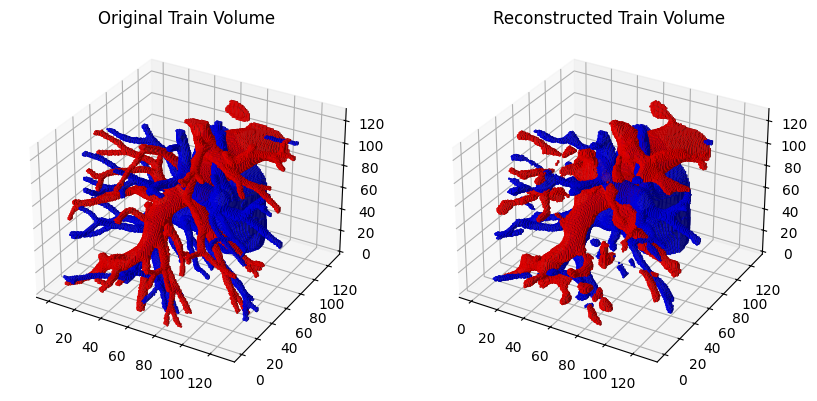

Validation: |          | 0/? [00:00<?, ?it/s]

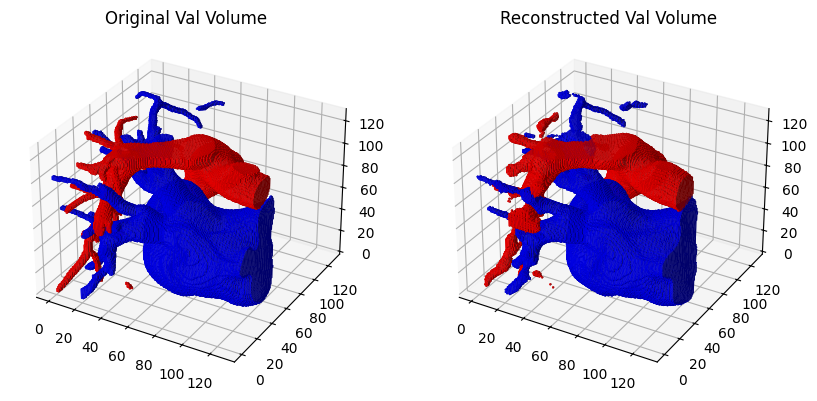

`Trainer.fit` stopped: `max_epochs=1501` reached.


Time Spent 57602.71


FIT Profiler Report

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  Action                                                                                                                                                         	|  Mean duration (s)	|  Num calls      	|  Total time (s) 	|  Percentage %   	|
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  Total                                                                                                                                                          	|  -              	|  723580         	|

In [3]:
model = AutoEncoderModel()
trainer.fit(model, train_dataloader, val_dataloader)

In [4]:
torch.save(model.state_dict(), folder_path + '/ae1.pth')